## Kaggle House Data Analysis

<img style="display: inline-block" src="https://github.com/mdaffailhami/mdaffailhami/assets/74972129/2eb8766e-63e7-4957-8412-9adc61fbc64b" width="130"></img>

|               |                                                                                |
| ------------- | ------------------------------------------------------------------------------ |
| **Nama**      | **Muhammad Daffa Ilhami**                                                      |
| **NIM**       | **E020322020**                                                                 |
| **Kelas**     | **MI 4A**                                                                      |
| **Portfolio** | [https://mdaffailhami.github.io](https://mdaffailhami.github.io)               |
| **GitHub**    | [https://github.com/mdaffailhami](https://github.com/mdaffailhami)             |
| **LinkedIn**  | [https://linkedin.com/in/mdaffailhami/](https://linkedin.com/in/mdaffailhami/) |

<br>
<hr>
<hr>


### Import Required Packages


In [25]:
from pathlib import Path
import pandas as pd
import folium

### Pandas Options


In [26]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)
pd.set_option('display.float_format', '{:.2f}'.format)

### Read Data File


In [27]:
# Membaca file data CSV
df = pd.read_csv(
    str(Path.cwd())+'/samples/kaggle_house_data.csv')

### Explanation of Every Field


| Field         | Description                                                |
| ------------- | ---------------------------------------------------------- |
| id            | ID unik dari rumah.                                        |
| year          | Tahun penjualan.                                           |
| month         | Bulan penjualan.                                           |
| date          | Tanggal penjualan.                                         |
| price         | Harga jual rumah.                                          |
| bedrooms      | Jumlah kamar tidur.                                        |
| bathrooms     | Jumlah kamar mandi.                                        |
| sqft_living   | Luas bangunan (dalam kaki persegi).                        |
| sqft_lot      | Luas tanah (dalam kaki persegi).                           |
| floors        | Jumlah lantai.                                             |
| waterfront    | Indikator jika rumah berada di tepi air.                   |
| view          | Indikator pandangan dari rumah.                            |
| condition     | Kondisi rumah.                                             |
| grade         | Kualitas konstruksi dan desain rumah.                      |
| sqft_above    | Luas bangunan di atas tanah (dalam kaki persegi).          |
| sqft_basement | Luas basement (dalam kaki persegi).                        |
| yr_built      | Tahun dibangun.                                            |
| yr_renovated  | Tahun direnovasi.                                          |
| zipcode       | Kode pos.                                                  |
| lat           | Garis lintang.                                             |
| long          | Garis bujur.                                               |
| sqft_living15 | Luas bangunan dari 15 rumah terdekat (dalam kaki persegi). |
| sqft_lot15    | Luas tanah dari 15 rumah terdekat (dalam kaki persegi).    |


### Statistics Descriptive


In [28]:
columns_to_describe = df.drop(columns=['id', 'zipcode', 'lat', 'long']).columns

df[columns_to_describe].describe()

,year,month,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,sqft_living15,sqft_lot15
count,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00
mean,2014.32,6.57,15.69,568359430.76,3.37,2.11,2079.90,15106.97,1.49,0.01,0.23,3.41,7.66,1788.39,291.51,1971.01,84.40,1986.55,12768.46
std,0.47,3.12,8.64,8515844389.69,0.93,0.77,918.44,41420.51,0.54,0.09,0.77,0.65,1.18,828.09,442.58,29.37,401.68,685.39,27304.18
min,2014.00,1.00,1.00,75000.00,0.00,0.00,290.00,520.00,1.00,0.00,0.00,1.00,1.00,290.00,0.00,1900.00,0.00,399.00,651.00
25%,2014.00,4.00,8.00,321950.00,3.00,1.75,1427.00,5040.00,1.00,0.00,0.00,3.00,7.00,1190.00,0.00,1951.00,0.00,1490.00,5100.00
50%,2014.00,6.00,16.00,450000.00,3.00,2.25,1910.00,7618.00,1.50,0.00,0.00,3.00,7.00,1560.00,0.00,1975.00,0.00,1840.00,7620.00
75%,2015.00,9.00,23.00,645000.00,4.00,2.50,2550.00,10688.00,2.00,0.00,0.00,4.00,8.00,2210.00,560.00,1997.00,0.00,2360.00,10083.00
max,2015.00,12.00,31.00,317000000000.00,33.00,8.00,13540.00,1651359.00,3.50,1.00,4.00,5.00,13.00,9410.00,4820.00,2015.00,2015.00,6210.00,871200.00


### Sales per Month


Table of Sales per Month


month,1,2,3,4,5,6,7,8,9,10,11,12
count,978,1250,1875,2231,2414,2180,2211,1940,1774,1878,1411,1471


<AxesSubplot:title={'center':'Sales per Month'}, xlabel='Months', ylabel='Sales'>

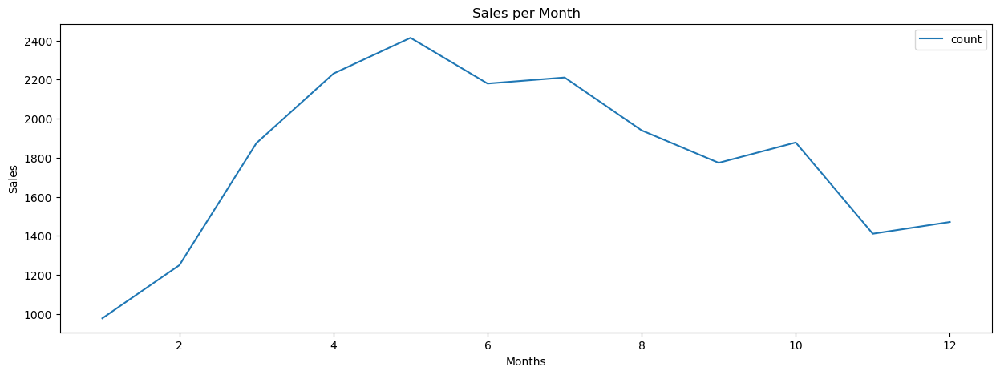

In [29]:
sales_per_month = df['month'].value_counts().sort_index()
table = pd.DataFrame(sales_per_month)

print('Table of Sales per Month')
display(table.transpose())

table.plot(figsize=(15, 5), title='Sales per Month',
           kind='line', xlabel='Months', ylabel='Sales')

### Total Price per Month


Table of Total Price per Month


month,1,2,3,4,5,6,7,8,9,10,11,12
price,369906972060.00,668239329504.00,810417198156.00,491566293556.00,1219821121289.00,1139813099745.00,2335035076568.00,1275004992457.00,1057246506350.00,1428406631403.00,607702925054.00,880792230856.00


<AxesSubplot:title={'center':'Total Price per Month'}, xlabel='Months', ylabel='Total Price'>

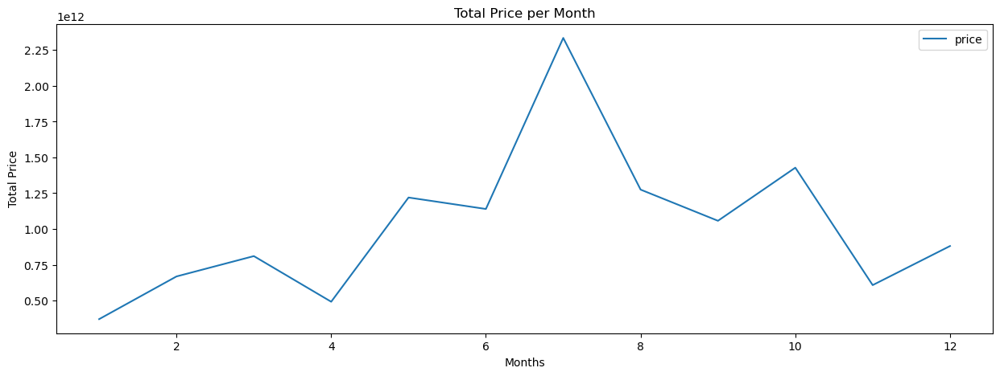

In [30]:
total_price_per_month = df.groupby('month')['price'].sum()
table = pd.DataFrame(total_price_per_month)

print("Table of Total Price per Month")
display(table.transpose())

table.plot(figsize=(15, 5), title='Total Price per Month',
           kind='line', xlabel='Months', ylabel='Total Price')

### Average Price Based on Number of Bedrooms and House Condition


Table of Average Price Based on Number of Bedrooms and House Condition


condition,1,2,3,4,5
bedrooms,,,,,
0,142000.00,228000.00,13110242295.00,139950.00,NaN
1,285500.00,245000.00,313574.47,26363782.29,315179.17
2,277291.67,275906.73,94654716.44,405984.61,618440319.76
3,400743.75,296336.46,142926191.62,39105698.31,425058177.52
4,445750.00,71513527.22,792383953.66,775902008.44,674820138.23
5,NaN,235500.00,3855201061.82,1614962323.17,2468456385.10
6,432500.00,524816.67,1086824388.75,93885410.34,271996133.91
7,NaN,NaN,48470594.40,321641128.56,1385000.00
8,NaN,NaN,792000.00,920000.00,2635000.00


<AxesSubplot:title={'center':'Average Price Based on Number of Bedrooms and House Condition'}, xlabel='Bedrooms', ylabel='Price'>

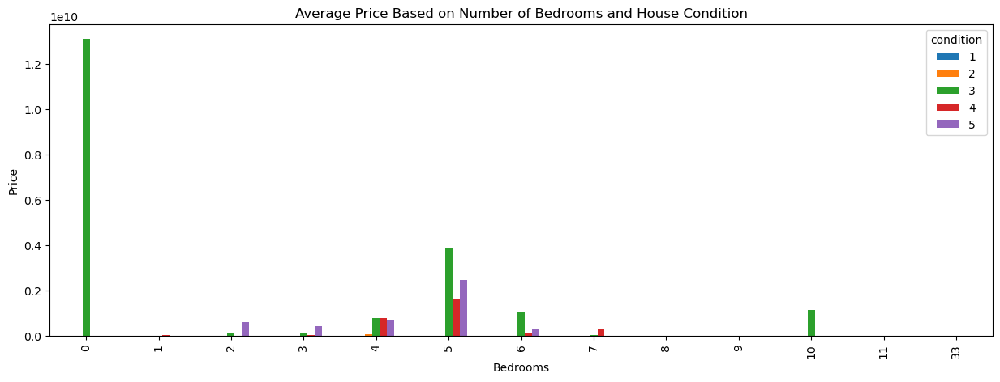

In [31]:
# This single line code will give a dataframe of column price where bedrooms = 0.
# print(df[df['bedrooms'] == 0]['price'])

table = pd.pivot_table(df, values='price', index='bedrooms',
                       columns='condition', aggfunc='mean')

print("Table of Average Price Based on Number of Bedrooms and House Condition")
display(table)

table.plot(figsize=(15, 5), title='Average Price Based on Number of Bedrooms and House Condition',
           kind='bar', xlabel='Bedrooms', ylabel='Price')

### Geospatial Map


In [35]:
# Buat peta dasar berpusat di King County
king_county_map = folium.Map(location=[47.6062, -122.3321], zoom_start=10)

# Tambahkan titik-titik lokasi rumah ke peta
for idx, row in df.iterrows():
    folium.CircleMarker(
        location=[row['lat'], row['long']],
        radius=5,
        color='blue',
        fill=True,
        fill_color='blue' if row['waterfront'] == 0 else 'aqua',
        fill_opacity=0.6,
        popup=f"Price: ${row['price']}, Bedrooms: {row['bedrooms']}, Bathrooms: {row['bathrooms']}"
    ).add_to(king_county_map)

# Simpan peta ke file HTML
# king_county_map.save(str(Path.cwd())+'/kaggle-house-geospatial-map.html')

# Tampilkan peta
king_county_map

In [34]:
df['waterfront'][0]

0